In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import torch

import os
import json
import plotly.graph_objects as go
import matplotlib.pyplot as plt

from data_process import waymo_data_util
import config.waymo_config as cnf

2023-10-07 21:03:51.614941: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
frm_list = waymo_data_util.get_frames("../../Data/waymo_data/segment-1051897962568538022_238_170_258_170_with_camera_labels.tfrecord")

2023-10-07 21:03:53.607431: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-07 21:03:53.608552: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.


In [3]:
waymo_data_util.visualize_frame(frm_list[14])

### Visualize the BEV with label

In [5]:
bev = waymo_data_util.BEV(frm_list[14])

In [6]:
bev.bev_map[2].shape

(1600, 1600)

In [7]:
def plot_bev(bev, x_min=0, x_max=1600, y_min=0, y_max=1600):
    img = np.zeros(bev.bev_map.shape, dtype=np.uint8)
    z0 = bev.bev_map[0].min()
    px, py = np.where(bev.bev_map[2] > 0)
    # Base
    img[0, px, py] = (((bev.bev_map[0, px, py] - z0) * 40).clip(0, 255)).astype(np.uint8)
    # Height
    img[1, px, py] = (((bev.bev_map[1, px, py] - bev.bev_map[0, px, py]) * 40).clip(0, 255)).astype(np.uint8)
    # Density
    img[2, px, py] = (bev.bev_map[2, px, py]*25).clip(0, 255).astype(np.uint8)
    
    plt.figure(figsize=(12, 12))
    plt.imshow(np.transpose(img, (1,2,0)))
    
    # Draw labels and bounding boxes
    for i, lb in enumerate(bev.labels):
        vertices_xy = waymo_data_util.get_vertices2D(lb.box)
        x0 = (lb.box.center_x - cnf.boundary["minX"]) / cnf.DX
        y0 = (lb.box.center_y - cnf.boundary["minY"]) / cnf.DY
        
        vertices_xy[:, 0] = vertices_xy[:, 0] / cnf.DX + x0
        vertices_xy[:, 1] = vertices_xy[:, 1] / cnf.DY + y0
        
        plt.plot(vertices_xy[[0,1,2,3,0], 1], vertices_xy[[0,1,2,3,0], 0], c='w')
        label_str = f"{waymo_data_util.class_list[lb.type-1]} {i}:\n dir={lb.box.heading:.2f}"
        plt.text(y0-40, x0, label_str, color='white')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)

    plt.show()

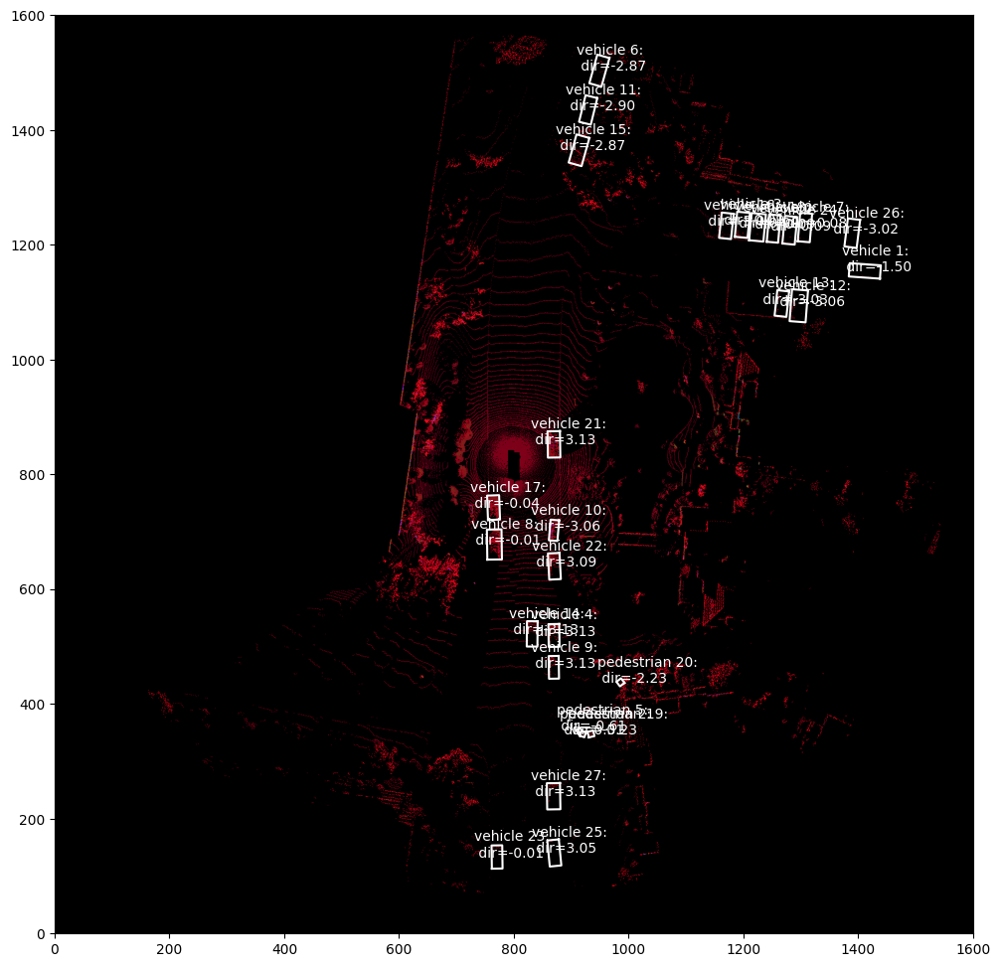

In [8]:
plot_bev(bev)

In [14]:
bev.build_targets()

x range = 300 to 313; y range = 310 to 316
x range = 285 to 291; y range = 345 to 359
x range = 85 to 88; y range = 228 to 231
x range = 302 to 314; y range = 296 to 302
x range = 124 to 134; y range = 215 to 219
x range = 87 to 89; y range = 227 to 229
x range = 368 to 382; y range = 232 to 241
x range = 301 to 313; y range = 323 to 329
x range = 162 to 176; y range = 188 to 194
x range = 110 to 120; y range = 215 to 219
x range = 170 to 180; y range = 215 to 219
x range = 352 to 365; y range = 228 to 236
x range = 266 to 280; y range = 320 to 328
x range = 268 to 280; y range = 313 to 319
x range = 124 to 136; y range = 205 to 210
x range = 334 to 348; y range = 223 to 232
x range = 302 to 314; y range = 289 to 295
x range = 180 to 190; y range = 188 to 193
x range = 301 to 313; y range = 302 to 309
x range = 85 to 88; y range = 232 to 235
x range = 107 to 111; y range = 244 to 248
x range = 207 to 218; y range = 214 to 220
x range = 154 to 165; y range = 214 to 220
x range = 28 to 3

In [15]:
bev.heat_map.max()

1.0

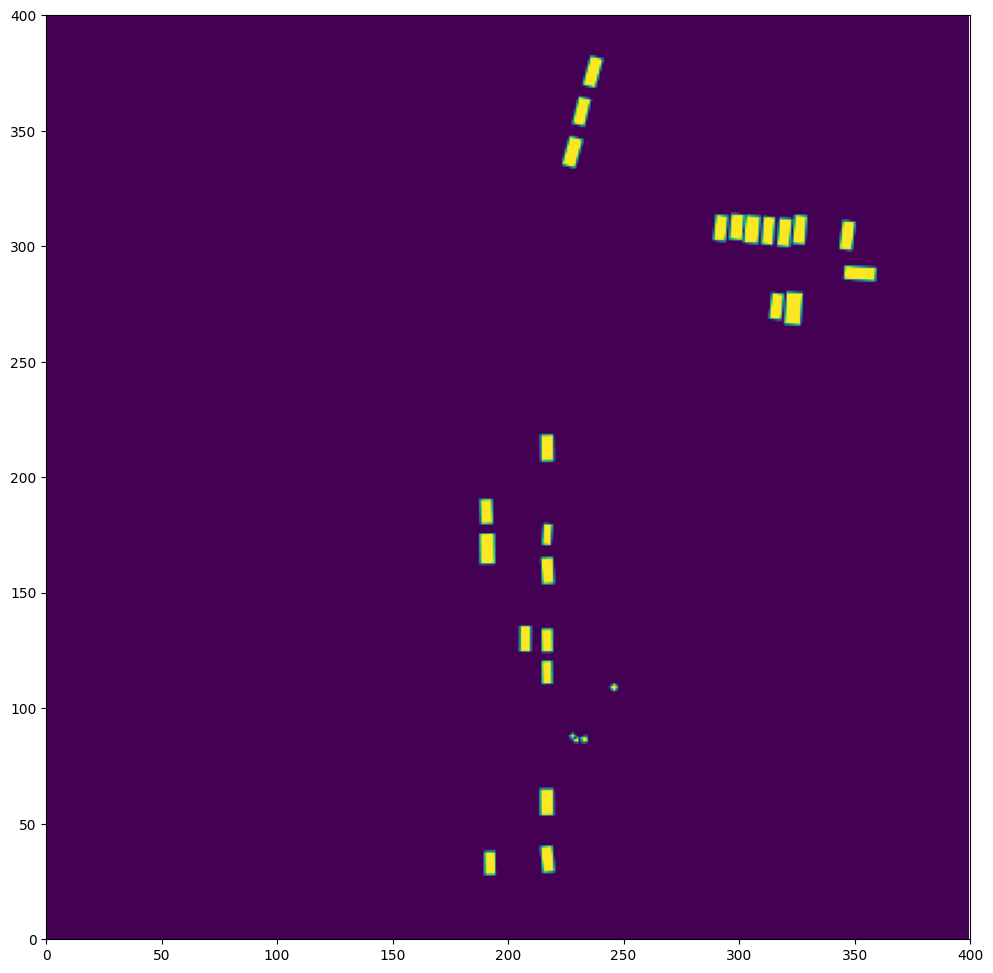

In [17]:
plt.figure(figsize=(12,12))
plt.xlim(0, 400)
plt.ylim(0, 400)
plt.imshow(bev.heat_map)